In [1]:
!pip install -q ultralytics

In [2]:
from ultralytics import YOLO
import cv2
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import os

In [3]:
# Load a model
model_seg = YOLO('yolov8x-seg.pt')  # load an official model

100%|██████████| 137M/137M [00:00<00:00, 294MB/s] 


In [4]:
image = cv2.imread('./bag_yolo_m/bags_yolo_m/train/bag1/frame_700.jpg')

# Predict with the model
results = model_seg(image)  # predict on an image


0: 384x640 14 persons, 1 handbag, 146.1ms
Speed: 13.1ms preprocess, 146.1ms inference, 2857.1ms postprocess per image at shape (1, 3, 384, 640)


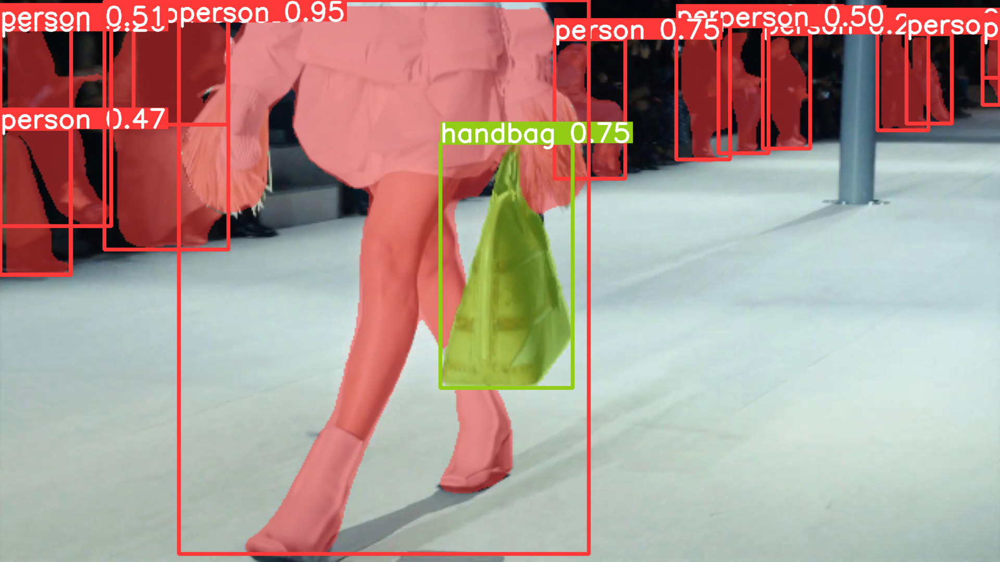

In [5]:
plot = results[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

In [6]:
bag_idx = [i for i in range(len(results[0].boxes.cls.tolist())) if int(results[0].boxes.cls.tolist()[i]) == 26][0]

print("Conf Boxe: ",results[0].boxes.conf[bag_idx].tolist())
print("Boxe xyxy: ",results[0].boxes.xyxy[bag_idx].tolist())

Conf Boxe:  0.7508291006088257
Boxe xyxy:  [845.2644653320312, 274.5995788574219, 1099.07177734375, 745.2540893554688]


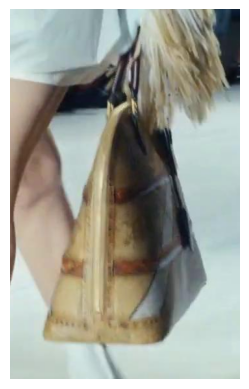

In [7]:
box_coords = results[0].boxes.xyxy[bag_idx].tolist()

# Extraire les coordonnées de la boîte
left, top, right, bottom = map(int, box_coords)

left = (0 if left - 50 < 0 else left - 50)
top = (0 if top - 50 < 0 else top - 50)

right = (image.shape[1] if right + 50 > image.shape[1] else right + 50)
bottom = (image.shape[0] if bottom + 50 > image.shape[0] else bottom + 50)

# Extraire la région de la boîte de l'image d'origine
box_region = image[top:bottom, left:right]

# Créer une nouvelle image avec la boîte sur un fond blanc
box_image = np.zeros((bottom - top, right - left, 3), dtype=np.uint8)
box_image.fill(255)  # Remplir avec du blanc
box_image[0:bottom - top, 0:right - left] = box_region

box_image_save = cv2.cvtColor(box_image, cv2.COLOR_BGR2RGB)

plt.imshow(box_image_save)
plt.axis('off')
plt.show()


0: 384x640 19 persons, 1 bench, 2 handbags, 32.7ms
Speed: 3.3ms preprocess, 32.7ms inference, 3.9ms postprocess per image at shape (1, 3, 384, 640)
Conf Boxe:  0.3701575696468353
Boxe xyxy:  [851.9353637695312, 502.98907470703125, 1204.3544921875, 822.1228637695312]


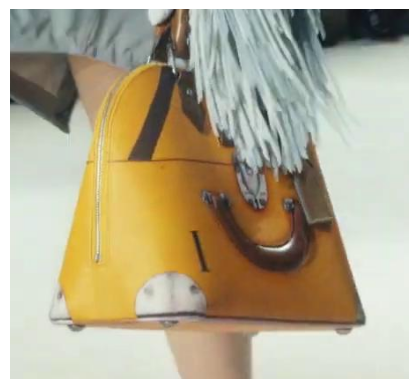


0: 384x640 10 persons, 2 benchs, 1 handbag, 32.6ms
Speed: 2.3ms preprocess, 32.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Conf Boxe:  0.3912544548511505
Boxe xyxy:  [719.6532592773438, 387.51177978515625, 1106.5404052734375, 729.139892578125]


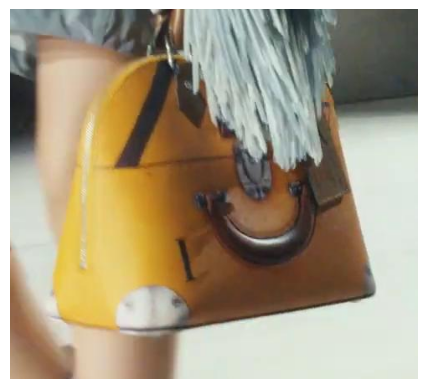


0: 384x640 8 persons, 1 suitcase, 32.8ms
Speed: 2.1ms preprocess, 32.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 7 persons, 1 bench, 1 suitcase, 32.7ms
Speed: 2.6ms preprocess, 32.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 11 persons, 4 benchs, 1 handbag, 32.7ms
Speed: 2.7ms preprocess, 32.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Conf Boxe:  0.6017498970031738
Boxe xyxy:  [750.640869140625, 307.1891784667969, 1079.408203125, 664.46630859375]


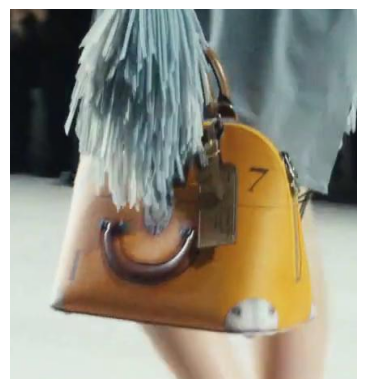

Number of Bags Pictures:  5
Number of Bags Identified:  3
Success Rate:  0.6


In [19]:
folder_path = './bag_yolo_m/bags_yolo_m/train/bag4'

success = 0

for pictures_path in sorted(os.listdir(folder_path)):

    image = cv2.imread(os.path.join(folder_path, pictures_path))
    
    # Predict with the model
    results = model_seg(image, conf=0.1)  # predict on an image
    
    # bag1 --> 0.0324
    # bag2 --> 0.1
    # bag3 --> 0.1
    # bag4 --> 0.1
    
    bag_idxs = [i for i in range(len(results[0].boxes.cls.tolist())) if int(results[0].boxes.cls.tolist()[i]) == 26]
    
    if len(bag_idxs) > 0:
        bag_idx = bag_idxs[0]
        
        print("Conf Boxe: ",results[0].boxes.conf[bag_idx].tolist())
        print("Boxe xyxy: ",results[0].boxes.xyxy[bag_idx].tolist())
        
        success += 1
        
        box_coords = results[0].boxes.xyxy[bag_idx].tolist()

        # Extraire les coordonnées de la boîte
        left, top, right, bottom = map(int, box_coords)

        left = (0 if left - 50 < 0 else left - 50)
        top = (0 if top - 50 < 0 else top - 50)

        right = (image.shape[1] if right + 50 > image.shape[1] else right + 50)
        bottom = (image.shape[0] if bottom + 50 > image.shape[0] else bottom + 50)

        # Extraire la région de la boîte de l'image d'origine
        box_region = image[top:bottom, left:right]

        # Créer une nouvelle image avec la boîte sur un fond blanc
        box_image = np.zeros((bottom - top, right - left, 3), dtype=np.uint8)
        box_image.fill(255)  # Remplir avec du blanc
        box_image[0:bottom - top, 0:right - left] = box_region

        box_image_save = cv2.cvtColor(box_image, cv2.COLOR_BGR2RGB)

        plt.imshow(box_image_save)
        plt.axis('off')
        plt.show()

print('Number of Bags Pictures: ', len(os.listdir(folder_path)))
print('Number of Bags Identified: ', success)
print('Success Rate: ', round(success/len(os.listdir(folder_path)), 2))

## Video Bags

In [22]:
# Chemin de la vidéo
video_path = "./Louis Vuitton Fall Winter 2024 Show.mp4"

In [27]:
def get_frame_from_video(video_path, frame_number):
    # Ouvrir la vidéo
    cap = cv2.VideoCapture(video_path)
    # Définir le numéro de frame
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_number)
    # Lire la frame
    ret, frame = cap.read()
    # Fermer la vidéo
    cap.release()
    return frame

### Bag 1

In [23]:
# Numéro de frame à extraire
start_frame_number = 700
end_frame_number = 830

folder_bag = './bag1'

if not os.path.exists(folder_bag):
    os.makedirs(folder_bag)

for i in range(start_frame_number, end_frame_number+1):
    # Obtenir la frame
    frame = get_frame_from_video(video_path, i)
    # Convertir la frame en image PIL
    image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    # Sauvegarder l'image
    image_path = f"frame_{i}.jpg"
    image.save(os.path.join(folder_bag, image_path))

### Bag 2

In [24]:
# Numéro de frame à extraire
start_frame_number = 1070
end_frame_number = 1140

folder_bag = './bag2'

if not os.path.exists(folder_bag):
    os.makedirs(folder_bag)

for i in range(start_frame_number, end_frame_number+1):
    # Obtenir la frame
    frame = get_frame_from_video(video_path, i)
    # Convertir la frame en image PIL
    image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    # Sauvegarder l'image
    image_path = f"frame_{i}.jpg"
    image.save(os.path.join(folder_bag, image_path))

### Bag 3

In [25]:
# Numéro de frame à extraire
start_frame_number = 2280
end_frame_number = 2347

folder_bag = './bag3'

if not os.path.exists(folder_bag):
    os.makedirs(folder_bag)

for i in range(start_frame_number, end_frame_number+1):
    # Obtenir la frame
    frame = get_frame_from_video(video_path, i)
    # Convertir la frame en image PIL
    image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    # Sauvegarder l'image
    image_path = f"frame_{i}.jpg"
    image.save(os.path.join(folder_bag, image_path))

### Bag 4

In [26]:
# Numéro de frame à extraire
start_frame_number = 2650
end_frame_number = 2710

folder_bag = './bag4'

if not os.path.exists(folder_bag):
    os.makedirs(folder_bag)

for i in range(start_frame_number, end_frame_number+1):
    # Obtenir la frame
    frame = get_frame_from_video(video_path, i)
    # Convertir la frame en image PIL
    image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    # Sauvegarder l'image
    image_path = f"frame_{i}.jpg"
    image.save(os.path.join(folder_bag, image_path))

## Zoom Bags

In [35]:
working_folder = './'

for folder in sorted(os.listdir(working_folder)):
    if folder.startswith('bag'):
        
        folder_path = os.path.join(working_folder, folder)
        print(folder_path)
        
        new_folder = folder + '_zoom'
        
        new_path = os.path.join(working_folder, new_folder)
        
        if not os.path.exists(new_path):
            os.makedirs(new_path)
        
        success = 0

        for pictures_path in sorted(os.listdir(folder_path)):

            image = cv2.imread(os.path.join(folder_path, pictures_path))
            index = pictures_path.split('.')[0].split('_')[-1]

            # Predict with the model
            results = model_seg(image, conf=0.1)  # predict on an image

            bag_idxs = [i for i in range(len(results[0].boxes.cls.tolist())) if int(results[0].boxes.cls.tolist()[i]) == 26]

            if len(bag_idxs) > 0:
                bag_idx = bag_idxs[0]

                print("Conf Boxe: ",results[0].boxes.conf[bag_idx].tolist())
                print("Boxe xyxy: ",results[0].boxes.xyxy[bag_idx].tolist())

                success += 1

                box_coords = results[0].boxes.xyxy[bag_idx].tolist()

                # Extraire les coordonnées de la boîte
                left, top, right, bottom = map(int, box_coords)

                left = (0 if left - 50 < 0 else left - 50)
                top = (0 if top - 50 < 0 else top - 50)

                right = (image.shape[1] if right + 50 > image.shape[1] else right + 50)
                bottom = (image.shape[0] if bottom + 50 > image.shape[0] else bottom + 50)

                # Extraire la région de la boîte de l'image d'origine
                box_region = image[top:bottom, left:right]

                # Créer une nouvelle image avec la boîte sur un fond blanc
                box_image = np.zeros((bottom - top, right - left, 3), dtype=np.uint8)
                box_image.fill(255)  # Remplir avec du blanc
                box_image[0:bottom - top, 0:right - left] = box_region
                
                box_path = f"{new_path}/box_{index}.jpg"
                cv2.imwrite(box_path, box_image)

        print('Number of Bags Pictures: ', len(os.listdir(folder_path)))
        print('Number of Bags Identified: ', success)
        print('Success Rate: ', round(success/len(os.listdir(folder_path)), 2))

/kaggle/working/bag1

0: 384x640 18 persons, 1 handbag, 33.1ms
Speed: 2.8ms preprocess, 33.1ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)
Conf Boxe:  0.7508291006088257
Boxe xyxy:  [845.2644653320312, 274.5995788574219, 1099.07177734375, 745.2540893554688]

0: 384x640 19 persons, 1 handbag, 32.7ms
Speed: 3.2ms preprocess, 32.7ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)
Conf Boxe:  0.717470645904541
Boxe xyxy:  [857.1536865234375, 286.2359619140625, 1109.7681884765625, 768.2579345703125]

0: 384x640 15 persons, 1 handbag, 32.8ms
Speed: 2.1ms preprocess, 32.8ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)
Conf Boxe:  0.8382774591445923
Boxe xyxy:  [872.5791015625, 281.21539306640625, 1122.262451171875, 771.6632080078125]

0: 384x640 14 persons, 1 bench, 1 handbag, 32.9ms
Speed: 2.1ms preprocess, 32.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)
Conf Boxe:  0.8782981634140015
Boxe xyxy:  [887.045898437

In [41]:
folder = './bags_yolo'
train_folder = './bags_yolo/train'
val_folder = './bags_yolo/val'

if not os.path.exists(folder):
    os.makedirs(folder)

if not os.path.exists(train_folder):
    os.makedirs(train_folder)

if not os.path.exists(val_folder):
    os.makedirs(val_folder)

In [42]:
import os
import random
import shutil

working_folder = './'

for folder in sorted(os.listdir(working_folder)):
    if folder.endswith('zoom'):
        
        # Class of bags
        bag = folder.split('_')[0]
        
        # Paths for train/val
        train_path = os.path.join(train_folder, bag)
        val_path = os.path.join(val_folder, bag)
        
        if not os.path.exists(train_path):
            os.makedirs(train_path)
        
        if not os.path.exists(val_path):
            os.makedirs(val_path)
        
        folder_path = os.path.join(working_folder, folder)
        print(folder_path)

        # Liste des noms de fichiers dans le dossier
        files = os.listdir(folder_path)
        random.shuffle(files)  # Mélangez aléatoirement les fichiers

        # Calculez la taille des ensembles d'entraînement et de validation
        total_files = len(files)
        train_size = int(0.8 * total_files)
        val_size = total_files - train_size

        # Copiez les fichiers dans les répertoires appropriés
        for i, file in enumerate(files):
            if i < train_size:
                shutil.copy(os.path.join(folder_path, file), train_path)
            else:
                shutil.copy(os.path.join(folder_path, file), val_path)


/kaggle/working/bag1_zoom
/kaggle/working/bag2_zoom
/kaggle/working/bag3_zoom
/kaggle/working/bag4_zoom


In [43]:
# Load a model
model_cls = YOLO('yolov8x-cls.pt')  # load a pretrained model (recommended for training)

# Train the model
results = model_cls.train(data='./bags_yolo', epochs=10, device=0)

100%|██████████| 110M/110M [00:00<00:00, 291MB/s] 


Ultralytics YOLOv8.2.2 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla P100-PCIE-16GB, 16276MiB)
engine/trainer: task=classify, mode=train, model=yolov8x-cls.pt, data=/kaggle/working/bags_yolo, epochs=10, time=None, patience=100, batch=16, imgsz=224, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True

2024-04-26 12:15:55,950	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
2024-04-26 12:15:56,719	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
2024-04-26 12:15:58.921596: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-26 12:15:58.921733: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-26 12:15:59.050584: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLA

Overriding model.yaml nc=1000 with nc=4

                   from  n    params  module                                       arguments                     
  0                  -1  1      2320  ultralytics.nn.modules.conv.Conv             [3, 80, 3, 2]                 
  1                  -1  1    115520  ultralytics.nn.modules.conv.Conv             [80, 160, 3, 2]               
  2                  -1  3    436800  ultralytics.nn.modules.block.C2f             [160, 160, 3, True]           
  3                  -1  1    461440  ultralytics.nn.modules.conv.Conv             [160, 320, 3, 2]              
  4                  -1  6   3281920  ultralytics.nn.modules.block.C2f             [320, 320, 6, True]           
  5                  -1  1   1844480  ultralytics.nn.modules.conv.Conv             [320, 640, 3, 2]              
  6                  -1  6  13117440  ultralytics.nn.modules.block.C2f             [640, 640, 6, True]           
  7                  -1  1   7375360  ultralyti

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...


100%|██████████| 6.23M/6.23M [00:00<00:00, 118MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/working/bags_yolo/train... 191 images, 0 corrupt: 100%|██████████| 191/191 [00:00<00:00, 2745.69it/s]

train: New cache created: /kaggle/working/bags_yolo/train.cache



val: Scanning /kaggle/working/bags_yolo/val... 50 images, 0 corrupt: 100%|██████████| 50/50 [00:00<00:00, 2239.61it/s]

val: New cache created: /kaggle/working/bags_yolo/val.cache


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 50 weight(decay=0.0), 51 weight(decay=0.0005), 51 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 224 train, 224 val
Using 4 dataloader workers
Logging results to runs/classify/train
Starting training for 10 epochs...

      Epoch    GPU_mem       loss  Instances       Size


       1/10      2.85G       1.39         16        224:  50%|█████     | 6/12 [00:01<00:01,  4.67it/s]

       1/10      2.85G      1.346         16        224:  92%|█████████▏| 11/12 [00:02<00:00,  6.08it/s]
100%|██████████| 755k/755k [00:00<00:00, 20.7MB/s]
               classes   top1_acc   top5_acc: 100%|██████████| 2/2 [00:00<00:00, 11.24it/s]


                   all       0.92          1

      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 2/2 [00:00<00:00, 14.42it/s]

                   all       0.96          1



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 2/2 [00:00<00:00, 14.58it/s]

                   all       0.94          1



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 2/2 [00:00<00:00, 14.52it/s]

                   all       0.94          1



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 2/2 [00:00<00:00, 14.57it/s]

                   all       0.94          1



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 2/2 [00:00<00:00, 14.31it/s]

                   all       0.96          1



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 2/2 [00:00<00:00, 14.79it/s]

                   all       0.96          1



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 2/2 [00:00<00:00, 14.93it/s]

                   all       0.98          1



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 2/2 [00:00<00:00, 14.93it/s]

                   all       0.98          1



      Epoch    GPU_mem       loss  Instances       Size


      10/10      2.93G    0.02432         15        224: 100%|██████████| 12/12 [00:01<00:00,  7.18it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 2/2 [00:00<00:00, 14.76it/s]

                   all       0.98          1



10 epochs completed in 0.013 hours.
Optimizer stripped from runs/classify/train/weights/last.pt, 112.5MB
Optimizer stripped from runs/classify/train/weights/best.pt, 112.5MB

Validating runs/classify/train/weights/best.pt...
Ultralytics YOLOv8.2.2 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla P100-PCIE-16GB, 16276MiB)
YOLOv8x-cls summary (fused): 133 layers, 56128324 parameters, 0 gradients, 153.8 GFLOPs
train: /kaggle/working/bags_yolo/train... found 191 images in 4 classes ✅ 
val: /kaggle/working/bags_yolo/val... found 50 images in 4 classes ✅ 
test: None...


               classes   top1_acc   top5_acc: 100%|██████████| 2/2 [00:00<00:00, 11.47it/s]


                   all       0.98          1
Speed: 0.1ms preprocess, 2.6ms inference, 0.0ms loss, 0.0ms postprocess per image
Results saved to runs/classify/train
Results saved to runs/classify/train


lr/pg0,▁▄▆▇██▇▆▄▁
lr/pg1,▁▄▆▇██▇▆▄▁
lr/pg2,▁▄▆▇██▇▆▄▁
metrics/accuracy_top1,▁▆▃▃▃▆▆███
metrics/accuracy_top5,▁▁▁▁▁▁▁▁▁▁
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/loss,█▆▄▂▁▁▁▁▁▁
val/loss,█▅▃▂▁▁▁▁▁▁
lr/pg0,8e-05


In [44]:
best_model = YOLO('./runs/classify/train/weights/best.pt')


image 1/1 /kaggle/input/mannequin-bag/frame_980.jpg: 224x224 bag2 0.40, bag1 0.27, bag3 0.27, bag4 0.06, 8.7ms
Speed: 18.1ms preprocess, 8.7ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


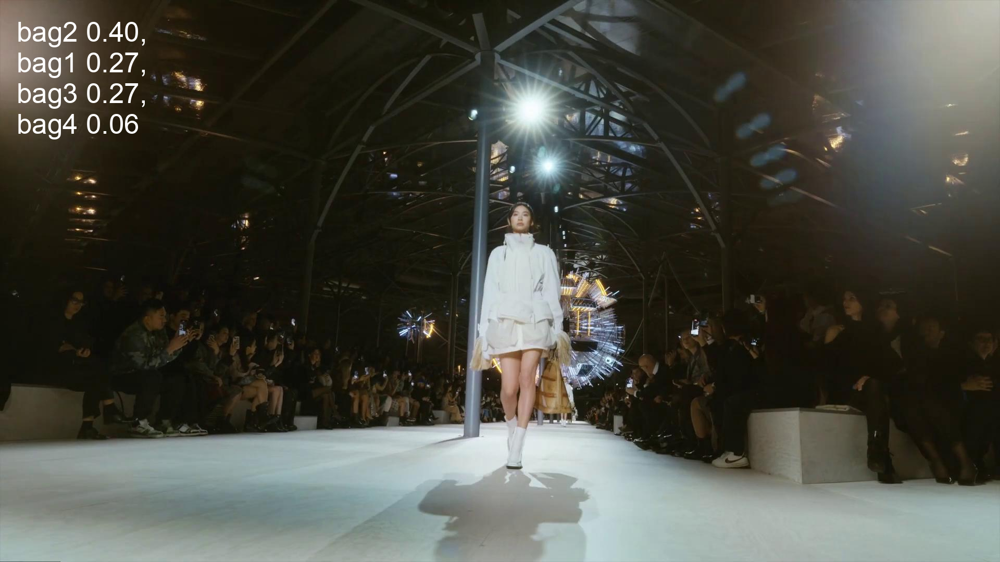


image 1/1 /kaggle/input/mannequin-bag/frame_2520.jpg: 224x224 bag1 0.40, bag2 0.29, bag3 0.25, bag4 0.05, 8.8ms
Speed: 18.5ms preprocess, 8.8ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


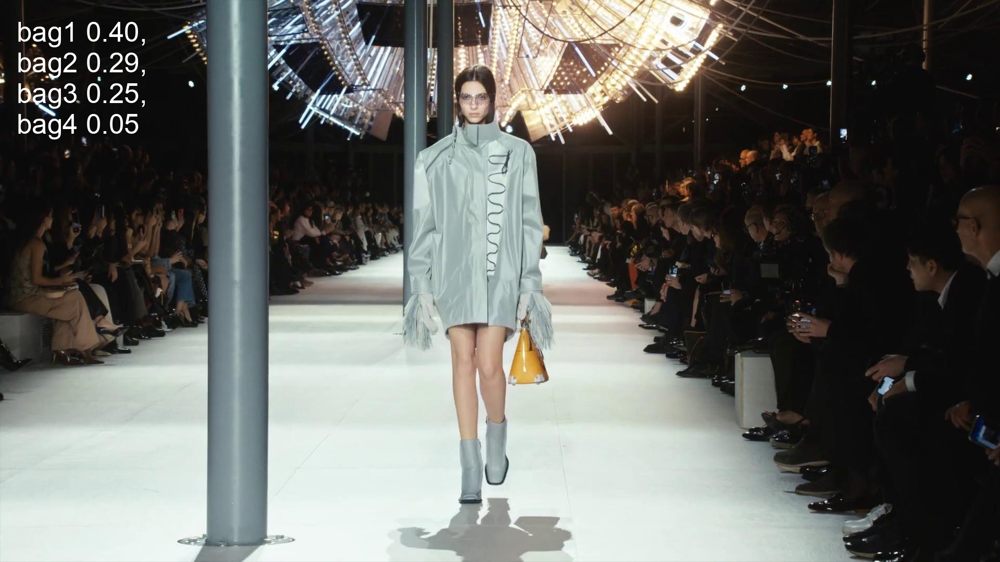


image 1/1 /kaggle/input/mannequin-bag/frame_2370.jpg: 224x224 bag2 0.35, bag1 0.33, bag3 0.26, bag4 0.05, 8.6ms
Speed: 18.4ms preprocess, 8.6ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


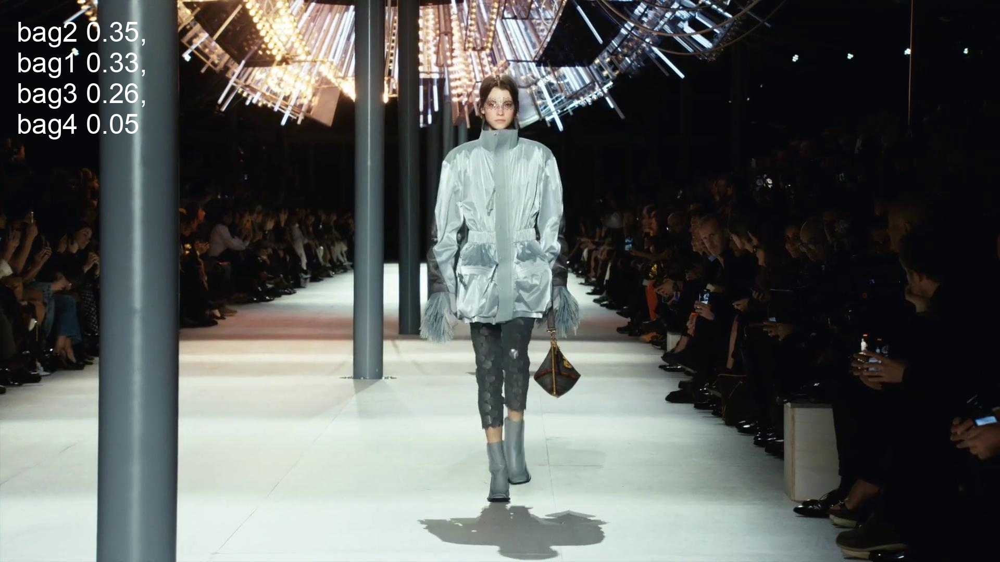


image 1/1 /kaggle/input/mannequin-bag/frame_1200.jpg: 224x224 bag1 0.40, bag2 0.36, bag3 0.20, bag4 0.04, 8.4ms
Speed: 17.7ms preprocess, 8.4ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


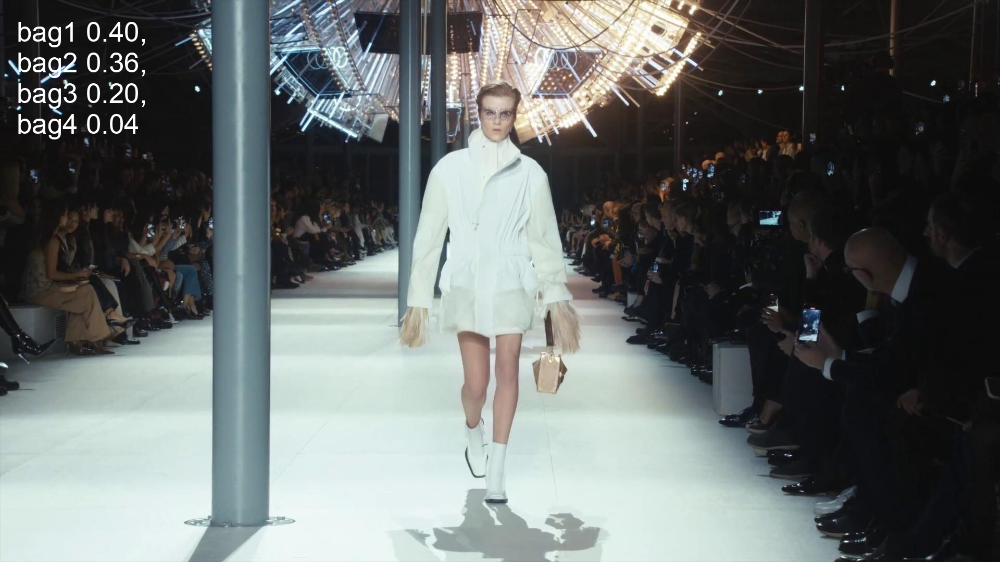


image 1/1 /kaggle/input/mannequin-bag/frame_1150.jpg: 224x224 bag2 0.45, bag1 0.35, bag3 0.17, bag4 0.04, 8.3ms
Speed: 17.7ms preprocess, 8.3ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


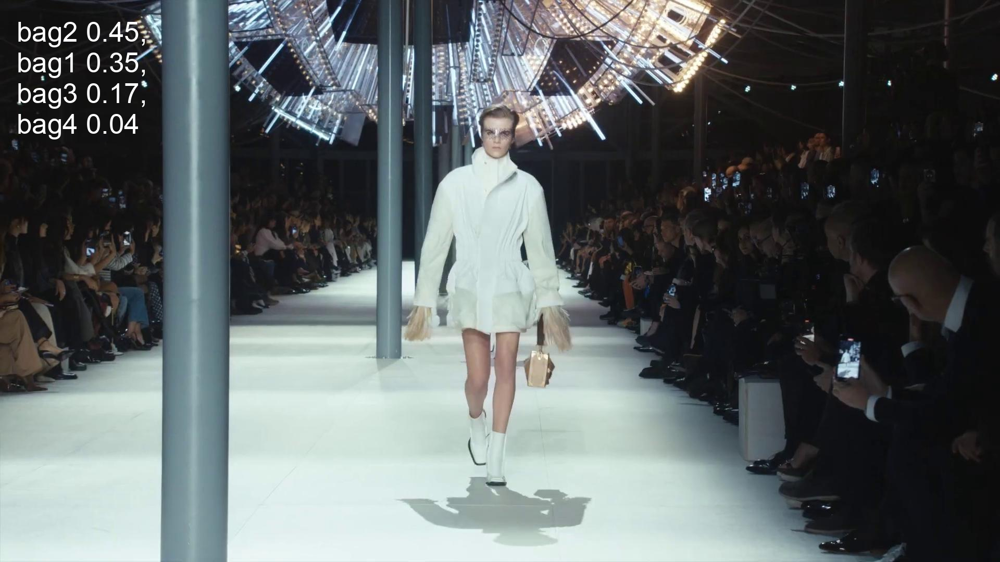


image 1/1 /kaggle/input/mannequin-bag/frame_2380.jpg: 224x224 bag2 0.39, bag1 0.29, bag3 0.27, bag4 0.05, 8.7ms
Speed: 17.5ms preprocess, 8.7ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


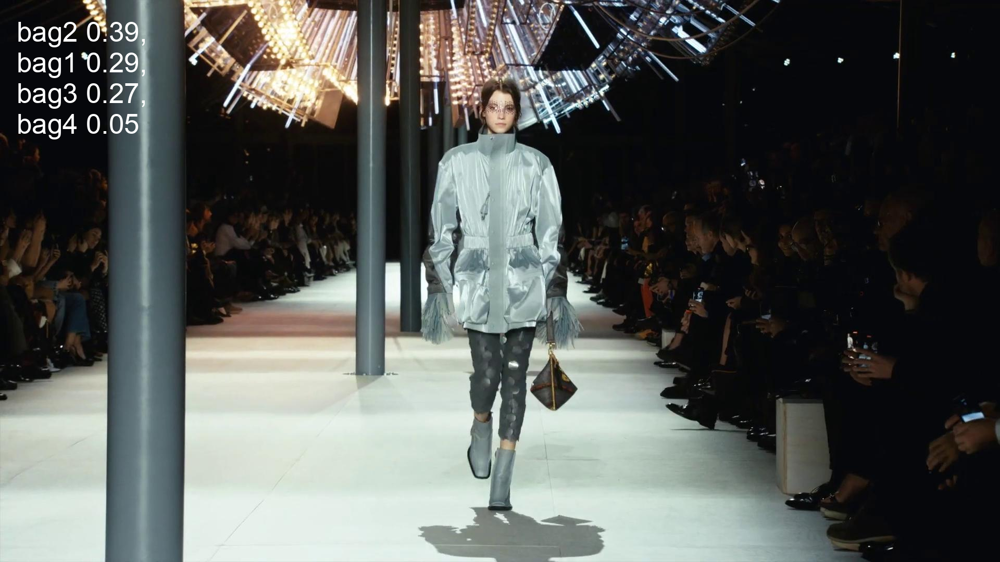


image 1/1 /kaggle/input/mannequin-bag/frame_2550.jpg: 224x224 bag1 0.37, bag2 0.31, bag3 0.27, bag4 0.06, 8.4ms
Speed: 17.4ms preprocess, 8.4ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


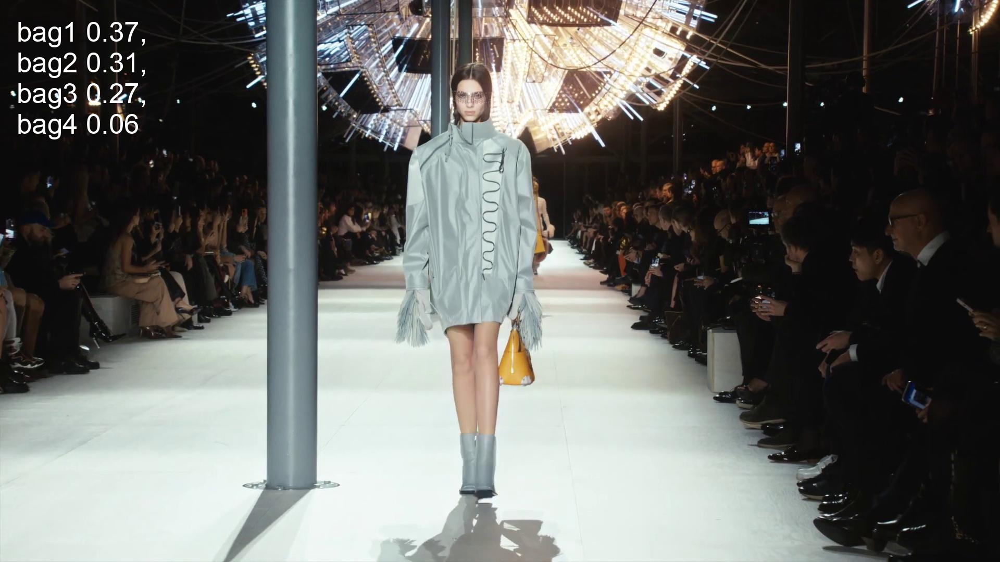


image 1/1 /kaggle/input/mannequin-bag/frame_940.jpg: 224x224 bag2 0.47, bag3 0.29, bag1 0.18, bag4 0.06, 8.4ms
Speed: 17.5ms preprocess, 8.4ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


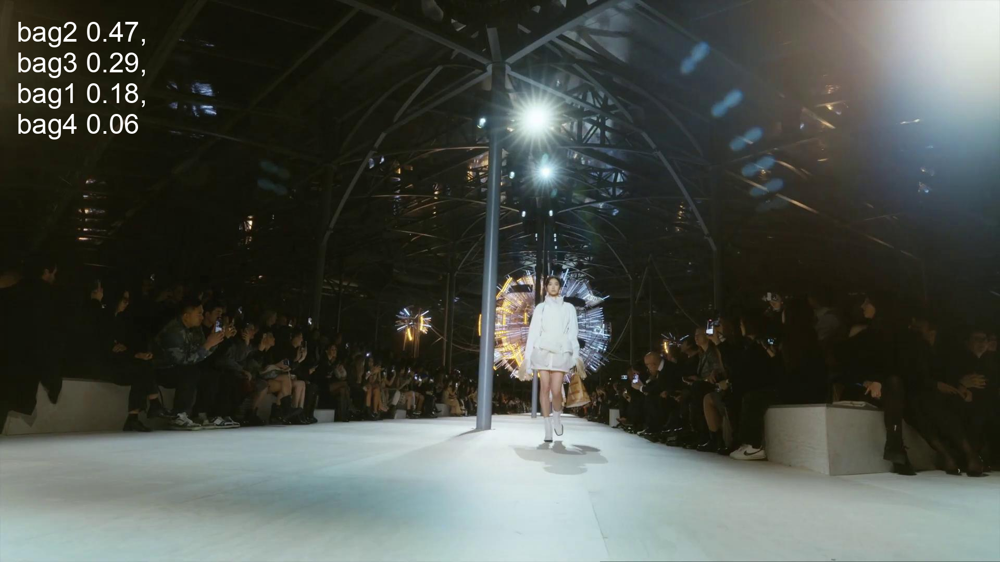


image 1/1 /kaggle/input/mannequin-bag/frame_1000.jpg: 224x224 bag2 0.40, bag1 0.28, bag3 0.25, bag4 0.07, 8.6ms
Speed: 17.7ms preprocess, 8.6ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


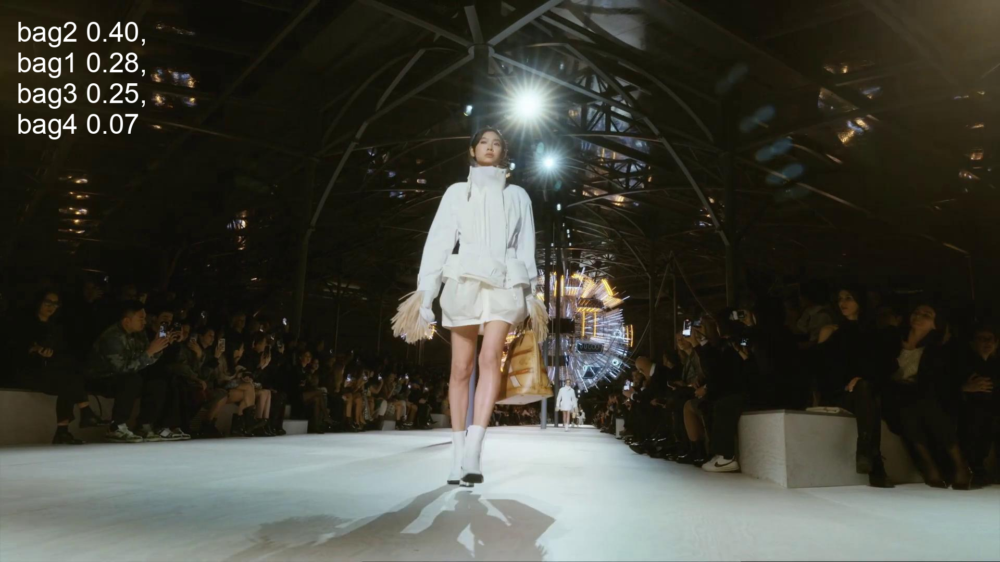


image 1/1 /kaggle/input/mannequin-bag/frame_1160.jpg: 224x224 bag2 0.40, bag1 0.31, bag3 0.26, bag4 0.04, 8.6ms
Speed: 17.8ms preprocess, 8.6ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


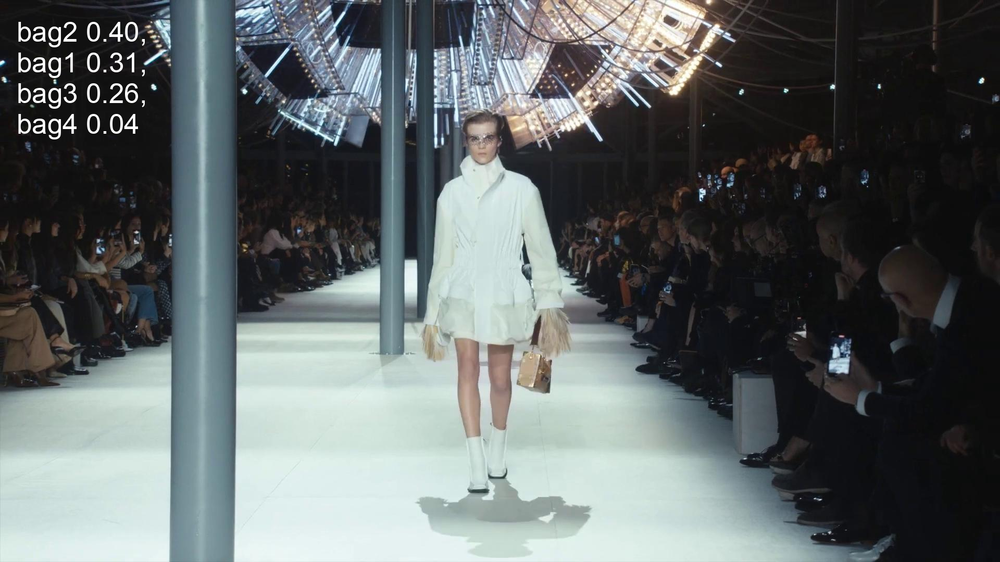


image 1/1 /kaggle/input/mannequin-bag/frame_2360.jpg: 224x224 bag1 0.33, bag2 0.31, bag3 0.31, bag4 0.04, 8.7ms
Speed: 17.6ms preprocess, 8.7ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


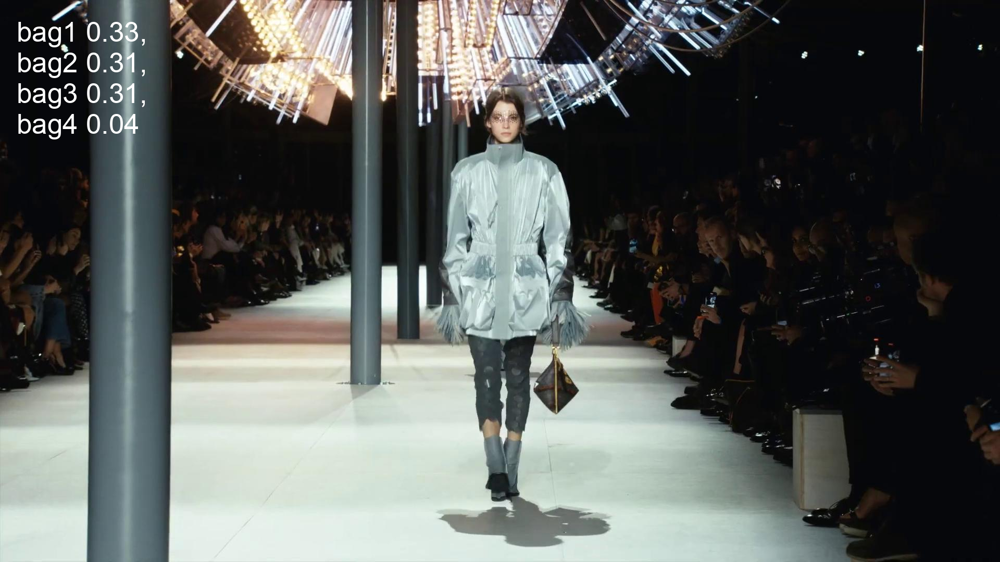


image 1/1 /kaggle/input/mannequin-bag/frame_2500.jpg: 224x224 bag1 0.36, bag2 0.31, bag3 0.29, bag4 0.05, 8.3ms
Speed: 17.2ms preprocess, 8.3ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


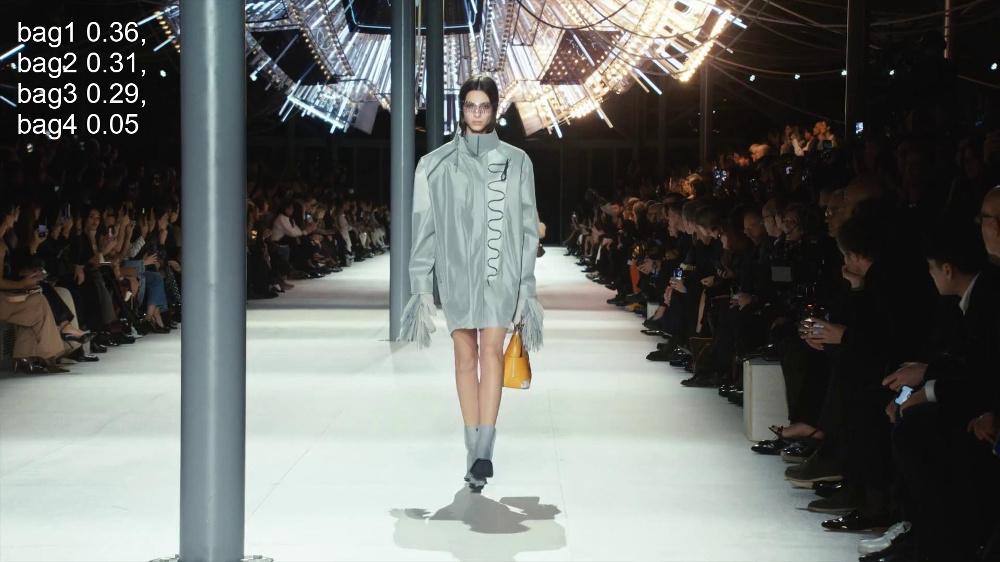

In [46]:
# Définir le chemin vers le dossier contenant les frames
frames_dir = './mannequin_bag'

for i, file_path in enumerate(os.listdir(frames_dir)):
    pred = best_model.predict(os.path.join(frames_dir, file_path))

    plot = pred[0].plot()
    plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
    display(Image.fromarray(plot))